In [1]:
import kagglehub
andrewmvd_face_mask_detection_path = kagglehub.dataset_download('andrewmvd/face-mask-detection')

print('Data source import complete.')


100%|██████████| 398M/398M [00:19<00:00, 21.9MB/s]

Extracting files...


Data source import complete.


In [2]:
import os
import torch
import xml.etree.ElementTree as ET
import pandas as pd
import numpy as np
import shutil
import torch
import matplotlib.pyplot as plt
import cv2
from sklearn.preprocessing import LabelEncoder

In [3]:
!pip install ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 905.3/905.3 kB 50.0 MB/s eta 0:00:00


In [5]:
# Import wandb and log in
import wandb

# Log in to wandb with API key
wandb.login(key='c6173cf27280b68511e3c01d809d179681002c51')

wandb: Using wandb-core as the SDK backend.  Please refer to https://wandb.me/wandb-core for more information.
wandb: Currently logged in as: emrebar26 (emrebar26-bahcesehir-u). Use `wandb login --relogin` to force relogin
wandb: WARNING If you're specifying your api key in code, ensure this code is not shared publicly.
wandb: WARNING Consider setting the WANDB_API_KEY environment variable, or running `wandb login` from the command line.
wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


True

In [7]:
ANNOTATIONS_DIR = "/root/.cache/kagglehub/datasets/andrewmvd/face-mask-detection/versions/1/annotations"
IMAGES_DIR = "/root/.cache/kagglehub/datasets/andrewmvd/face-mask-detection/versions/1/images"
OUTPUT_DIR = "/kaggle/working/face-mask-detection-yolo"

In [8]:
ANNOTATIONS_DIR = "/root/.cache/kagglehub/datasets/andrewmvd/face-mask-detection/versions/1/annotations"
IMAGES_DIR = "/root/.cache/kagglehub/datasets/andrewmvd/face-mask-detection/versions/1/images"
OUTPUT_DIR = "/kaggle/working/face-mask-detection-yolo"

os.makedirs(os.path.join(OUTPUT_DIR, 'images', 'train'), exist_ok=True)
os.makedirs(os.path.join(OUTPUT_DIR, 'images', 'val'), exist_ok=True)
os.makedirs(os.path.join(OUTPUT_DIR, 'labels', 'train'), exist_ok=True)
os.makedirs(os.path.join(OUTPUT_DIR, 'labels', 'val'), exist_ok=True)

In [9]:
annotations = []
for xml_file in os.listdir(ANNOTATIONS_DIR):
    tree = ET.parse(os.path.join(ANNOTATIONS_DIR, xml_file))
    root = tree.getroot()
    file_name = root.find('filename').text
    objects = []
    for obj in root.findall('object'):
        class_name = obj.find('name').text
        bndbox = obj.find('bndbox')
        xmin = int(bndbox.find('xmin').text)
        ymin = int(bndbox.find('ymin').text)
        xmax = int(bndbox.find('xmax').text)
        ymax = int(bndbox.find('ymax').text)
        objects.append((class_name, xmin, ymin, xmax, ymax))
    annotations.append((file_name, objects))

In [10]:
train_annotations = annotations[:int(0.8*len(annotations))]
val_annotations = annotations[int(0.8*len(annotations)):]

In [11]:
label_encoder = LabelEncoder()
all_labels = [obj[0] for ann in annotations for obj in ann[1]]
label_encoder.fit(all_labels)

LabelEncoder()

In [12]:
def convert_to_yolo_format(size, box):
    dw = 1./size[0]
    dh = 1./size[1]
    x = (box[0] + box[2]) / 2.0
    y = (box[1] + box[3]) / 2.0
    w = box[2] - box[0]
    h = box[3] - box[1]
    x = x*dw
    w = w*dw
    y = y*dh
    h = h*dh
    return (x,y,w,h)

In [13]:
# Save images and labels in YOLO format
def save_yolo_files(annotations, image_dir, label_dir):
    for file_name, objects in annotations:
        img_path = os.path.join(IMAGES_DIR, file_name)
        img = cv2.imread(img_path)
        h, w, _ = img.shape
        shutil.copy(img_path, image_dir)
        label_path = os.path.join(label_dir, file_name.replace('.png', '.txt'))
        with open(label_path, 'w') as f:
            for obj in objects:
                class_name, xmin, ymin, xmax, ymax = obj
                class_id = label_encoder.transform([class_name])[0]
                bb = convert_to_yolo_format((w, h), (xmin, ymin, xmax, ymax))
                f.write(f"{class_id} {' '.join(map(str, bb))}\n")

# Save train and val data
save_yolo_files(train_annotations, os.path.join(OUTPUT_DIR, 'images', 'train'), os.path.join(OUTPUT_DIR, 'labels', 'train'))
save_yolo_files(val_annotations, os.path.join(OUTPUT_DIR, 'images', 'val'), os.path.join(OUTPUT_DIR, 'labels', 'val'))

In [14]:
# Create data.yaml file
data_yaml = f"""
train: {os.path.join(OUTPUT_DIR, 'images', 'train')}
val: {os.path.join(OUTPUT_DIR, 'images', 'val')}

nc: {len(label_encoder.classes_)}
names: {label_encoder.classes_.tolist()}
"""

with open(os.path.join(OUTPUT_DIR, 'data.yaml'), 'w') as f:
    f.write(data_yaml)

In [15]:
# Train YOLOv8 model
from ultralytics import YOLO

# Create a YOLOv8 model
model = YOLO('yolov8n.pt')

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


100%|██████████| 6.25M/6.25M [00:00<00:00, 289MB/s]


In [16]:
# Train the model
model.train(data=os.path.join(OUTPUT_DIR, 'data.yaml'), epochs=80, imgsz=416, batch=16, cache=True,device=0)

Ultralytics 8.3.58 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (NVIDIA A100-SXM4-40GB, 40514MiB)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=/kaggle/working/face-mask-detection-yolo/data.yaml, epochs=80, time=None, patience=100, batch=16, imgsz=416, save=True, save_period=-1, cache=True, device=0, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels

100%|██████████| 755k/755k [00:00<00:00, 94.2MB/s]


Overriding model.yaml nc=80 with nc=3

                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      7360  ultralytics.nn.modules.block.C2f             [32, 32, 1, True]             
  3                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  4                  -1  2     49664  ultralytics.nn.modules.block.C2f             [64, 64, 2, True]             
  5                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  6                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  7                  -1  1    295424  ultralytics

100%|██████████| 5.35M/5.35M [00:00<00:00, 236MB/s]


AMP: checks passed ✅


train: Scanning /kaggle/working/face-mask-detection-yolo/labels/train... 682 images, 0 backgrounds, 0 corrupt: 100%|██████████| 682/682 [00:01<00:00, 443.90it/s]


train: New cache created: /kaggle/working/face-mask-detection-yolo/labels/train.cache
WARNING ⚠️ cache='ram' may produce non-deterministic training results. Consider cache='disk' as a deterministic alternative if your disk space allows.


train: Caching images (0.2GB RAM): 100%|██████████| 682/682 [00:01<00:00, 513.83it/s]


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


/usr/local/lib/python3.10/dist-packages/albumentations/__init__.py:24: UserWarning: A new version of Albumentations is available: 1.4.24 (you have 1.4.20). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()
val: Scanning /kaggle/working/face-mask-detection-yolo/labels/val... 171 images, 0 backgrounds, 0 corrupt: 100%|██████████| 171/171 [00:00<00:00, 308.81it/s]

val: New cache created: /kaggle/working/face-mask-detection-yolo/labels/val.cache


WARNING ⚠️ cache='ram' may produce non-deterministic training results. Consider cache='disk' as a deterministic alternative if your disk space allows.


val: Caching images (0.1GB RAM): 100%|██████████| 171/171 [00:00<00:00, 489.94it/s]


Plotting labels to runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001429, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 416 train, 416 val
Using 8 dataloader workers
Logging results to runs/detect/train
Starting training for 80 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/80      1.17G      1.805      2.634      1.302         86        416: 100%|██████████| 43/43 [00:05<00:00,  7.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.60it/s]

                   all        171        911      0.978     0.0871      0.244      0.127



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/80      1.07G      1.369       1.33      1.021         53        416: 100%|██████████| 43/43 [00:03<00:00, 11.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:00<00:00,  8.19it/s]


                   all        171        911      0.521      0.274      0.368      0.201

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/80      1.08G      1.312       1.16     0.9928         61        416: 100%|██████████| 43/43 [00:03<00:00, 11.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:00<00:00,  7.63it/s]

                   all        171        911      0.816       0.34      0.384      0.219



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/80      1.03G      1.234      1.045     0.9854        105        416: 100%|██████████| 43/43 [00:03<00:00, 12.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:00<00:00,  8.66it/s]


                   all        171        911      0.488      0.442      0.418      0.249

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/80      1.07G      1.206     0.9735     0.9845         50        416: 100%|██████████| 43/43 [00:03<00:00, 12.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:00<00:00,  7.90it/s]

                   all        171        911      0.643      0.484      0.521      0.316



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/80      1.06G      1.142     0.8826     0.9604         43        416: 100%|██████████| 43/43 [00:03<00:00, 11.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:00<00:00,  8.63it/s]


                   all        171        911      0.658      0.545      0.557       0.33

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/80      1.07G      1.123     0.8414      0.945         65        416: 100%|██████████| 43/43 [00:03<00:00, 11.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:00<00:00,  8.41it/s]


                   all        171        911      0.619      0.464      0.509      0.315

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/80      1.05G      1.121     0.8244     0.9447         93        416: 100%|██████████| 43/43 [00:03<00:00, 12.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:00<00:00,  8.59it/s]


                   all        171        911      0.664       0.52      0.547      0.331

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/80      1.09G      1.124     0.7875     0.9436         61        416: 100%|██████████| 43/43 [00:03<00:00, 11.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:00<00:00,  8.23it/s]

                   all        171        911        0.7      0.547      0.594      0.376



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/80      1.07G       1.06      0.759      0.937         53        416: 100%|██████████| 43/43 [00:03<00:00, 12.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:00<00:00,  8.81it/s]

                   all        171        911      0.713      0.482      0.551      0.344



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/80      1.12G      1.078     0.7415     0.9356         65        416: 100%|██████████| 43/43 [00:03<00:00, 12.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:00<00:00,  8.97it/s]

                   all        171        911      0.698      0.584      0.602      0.376



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/80      1.12G      1.048     0.7188     0.9262         69        416: 100%|██████████| 43/43 [00:03<00:00, 12.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:00<00:00,  8.71it/s]

                   all        171        911      0.631      0.583      0.589      0.371



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/80       1.1G      1.041     0.6893     0.9209        101        416: 100%|██████████| 43/43 [00:03<00:00, 11.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:00<00:00,  8.68it/s]

                   all        171        911      0.735      0.511      0.582       0.36



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/80      1.04G      1.023      0.678     0.9257         73        416: 100%|██████████| 43/43 [00:03<00:00, 12.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:00<00:00,  8.92it/s]

                   all        171        911      0.696      0.597      0.603      0.379



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/80      1.12G     0.9943     0.6545     0.9141         68        416: 100%|██████████| 43/43 [00:03<00:00, 12.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:00<00:00,  9.11it/s]

                   all        171        911      0.807      0.573      0.648      0.404



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/80      1.07G     0.9612     0.6307     0.9082         44        416: 100%|██████████| 43/43 [00:03<00:00, 11.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:00<00:00,  8.24it/s]


                   all        171        911      0.782      0.596      0.663      0.422

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/80      1.05G     0.9972     0.6496     0.9184         48        416: 100%|██████████| 43/43 [00:03<00:00, 12.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:00<00:00,  8.85it/s]

                   all        171        911      0.708      0.552      0.585      0.371



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/80       1.2G     0.9574      0.623     0.9079         30        416: 100%|██████████| 43/43 [00:03<00:00, 12.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:00<00:00,  8.96it/s]

                   all        171        911      0.748      0.575      0.634      0.399



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/80      1.03G     0.9785     0.6178     0.9064         54        416: 100%|██████████| 43/43 [00:03<00:00, 11.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:00<00:00,  8.86it/s]

                   all        171        911      0.753      0.591      0.648      0.425



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/80      1.03G     0.9453     0.5991     0.9074        140        416: 100%|██████████| 43/43 [00:03<00:00, 12.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:00<00:00,  8.86it/s]

                   all        171        911      0.791      0.564      0.643       0.41



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/80      1.02G      0.975     0.6237     0.9113        110        416: 100%|██████████| 43/43 [00:03<00:00, 12.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:00<00:00,  8.78it/s]

                   all        171        911      0.852      0.594      0.666      0.428



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/80      1.08G     0.9451      0.588     0.9011         60        416: 100%|██████████| 43/43 [00:03<00:00, 12.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:00<00:00,  8.66it/s]

                   all        171        911      0.834      0.599       0.68      0.444



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/80      1.06G     0.9284     0.5958     0.9017        106        416: 100%|██████████| 43/43 [00:03<00:00, 12.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:00<00:00,  8.97it/s]

                   all        171        911      0.825      0.598      0.667      0.447



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/80      1.07G     0.9097     0.5612     0.8961         65        416: 100%|██████████| 43/43 [00:03<00:00, 12.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:00<00:00,  8.79it/s]


                   all        171        911      0.804      0.575      0.636      0.417

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/80      1.05G     0.9173     0.5657     0.8885         75        416: 100%|██████████| 43/43 [00:03<00:00, 12.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:00<00:00,  8.96it/s]

                   all        171        911      0.776      0.599      0.672      0.435



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/80      1.05G     0.9045      0.555     0.8945         54        416: 100%|██████████| 43/43 [00:03<00:00, 11.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:00<00:00,  8.82it/s]

                   all        171        911      0.841      0.593      0.676      0.444



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/80      1.02G      0.885     0.5495     0.8866         59        416: 100%|██████████| 43/43 [00:03<00:00, 12.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:00<00:00,  9.12it/s]

                   all        171        911      0.765      0.577      0.645      0.417



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/80      1.06G     0.8801     0.5428     0.8836         72        416: 100%|██████████| 43/43 [00:03<00:00, 12.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:00<00:00,  9.04it/s]

                   all        171        911      0.849      0.584      0.659      0.422



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/80      1.05G     0.8718     0.5439     0.8876         99        416: 100%|██████████| 43/43 [00:03<00:00, 12.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:00<00:00,  8.79it/s]

                   all        171        911      0.734      0.631      0.644      0.414



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/80      1.05G     0.8762     0.5349     0.8843         63        416: 100%|██████████| 43/43 [00:03<00:00, 11.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:00<00:00,  8.90it/s]

                   all        171        911      0.732      0.587      0.632      0.405



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/80      1.05G     0.8617     0.5194     0.8819        107        416: 100%|██████████| 43/43 [00:03<00:00, 12.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:00<00:00,  8.65it/s]

                   all        171        911      0.827      0.626      0.672      0.425



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/80      1.08G     0.8492     0.5154     0.8754         67        416: 100%|██████████| 43/43 [00:03<00:00, 12.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:00<00:00,  8.60it/s]

                   all        171        911      0.794      0.646      0.702      0.463



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/80      1.13G     0.8387      0.507     0.8713         96        416: 100%|██████████| 43/43 [00:03<00:00, 12.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:00<00:00,  9.26it/s]

                   all        171        911      0.847      0.581      0.671       0.43



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/80      1.08G     0.8503     0.5134      0.881         83        416: 100%|██████████| 43/43 [00:03<00:00, 12.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:00<00:00,  8.97it/s]

                   all        171        911      0.839      0.629      0.696      0.449



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/80      1.07G     0.8337     0.5054     0.8796         62        416: 100%|██████████| 43/43 [00:03<00:00, 12.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:00<00:00,  9.17it/s]

                   all        171        911       0.89      0.615      0.697      0.454



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/80      1.08G     0.8149     0.4974     0.8712         60        416: 100%|██████████| 43/43 [00:03<00:00, 12.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:00<00:00,  8.85it/s]

                   all        171        911      0.815      0.573      0.664      0.429



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/80      1.06G     0.7984      0.493      0.868         73        416: 100%|██████████| 43/43 [00:03<00:00, 11.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:00<00:00,  8.88it/s]

                   all        171        911      0.805      0.576      0.654      0.419



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/80      1.06G     0.7991     0.4842     0.8717         84        416: 100%|██████████| 43/43 [00:03<00:00, 12.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:00<00:00,  9.13it/s]

                   all        171        911      0.818      0.598       0.69      0.439



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/80      1.06G     0.8058     0.4842     0.8676        113        416: 100%|██████████| 43/43 [00:03<00:00, 12.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:00<00:00,  8.56it/s]


                   all        171        911      0.719      0.651      0.698      0.446

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/80      1.06G     0.7663      0.467     0.8627         53        416: 100%|██████████| 43/43 [00:03<00:00, 11.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:00<00:00,  8.67it/s]

                   all        171        911       0.78      0.632      0.699      0.455



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/80      1.19G      0.785     0.4777     0.8721         51        416: 100%|██████████| 43/43 [00:03<00:00, 12.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:00<00:00,  8.91it/s]

                   all        171        911       0.86      0.612      0.685      0.438



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/80      1.06G     0.7658     0.4679     0.8652         77        416: 100%|██████████| 43/43 [00:03<00:00, 12.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:00<00:00,  9.00it/s]

                   all        171        911       0.76      0.606      0.676      0.432



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/80       1.1G     0.7951     0.4828      0.869         57        416: 100%|██████████| 43/43 [00:03<00:00, 12.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:00<00:00,  8.97it/s]

                   all        171        911      0.796      0.605      0.662      0.433



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/80      1.08G     0.7812     0.4665     0.8578         61        416: 100%|██████████| 43/43 [00:03<00:00, 12.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:00<00:00,  8.89it/s]

                   all        171        911      0.849      0.636      0.692      0.449



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/80      1.06G      0.757     0.4518     0.8574         65        416: 100%|██████████| 43/43 [00:03<00:00, 12.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:00<00:00,  8.93it/s]

                   all        171        911      0.799        0.6      0.693       0.45



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/80      1.07G     0.7557     0.4482     0.8559         61        416: 100%|██████████| 43/43 [00:03<00:00, 12.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:00<00:00,  8.75it/s]

                   all        171        911      0.869      0.597      0.684      0.457



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/80      1.13G     0.7549     0.4526      0.857        104        416: 100%|██████████| 43/43 [00:03<00:00, 11.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:00<00:00,  8.87it/s]

                   all        171        911      0.771      0.608      0.676       0.44



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/80      1.04G     0.7532     0.4502     0.8608         50        416: 100%|██████████| 43/43 [00:03<00:00, 12.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:00<00:00,  9.25it/s]

                   all        171        911       0.79      0.624      0.687      0.446



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/80      1.04G     0.7432     0.4467     0.8574         59        416: 100%|██████████| 43/43 [00:03<00:00, 12.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:00<00:00,  8.91it/s]

                   all        171        911      0.847      0.632      0.713      0.475



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/80      1.06G     0.7188      0.433     0.8502         54        416: 100%|██████████| 43/43 [00:03<00:00, 12.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:00<00:00,  8.74it/s]

                   all        171        911      0.856       0.61      0.671      0.435



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      51/80      1.18G     0.7307     0.4428     0.8535         93        416: 100%|██████████| 43/43 [00:03<00:00, 11.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:00<00:00,  9.01it/s]

                   all        171        911      0.848      0.618      0.702      0.456



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      52/80      1.07G     0.7222     0.4305     0.8503         44        416: 100%|██████████| 43/43 [00:03<00:00, 12.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:00<00:00,  8.81it/s]

                   all        171        911      0.873      0.658      0.726      0.479



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      53/80      1.06G     0.7472     0.4444     0.8564        105        416: 100%|██████████| 43/43 [00:03<00:00, 12.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:00<00:00,  8.85it/s]

                   all        171        911      0.776      0.641      0.713      0.469



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      54/80      1.06G     0.6992      0.421     0.8515         53        416: 100%|██████████| 43/43 [00:03<00:00, 11.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:00<00:00,  8.27it/s]

                   all        171        911      0.784      0.639      0.683      0.453



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      55/80      1.21G     0.7016     0.4156     0.8474         58        416: 100%|██████████| 43/43 [00:03<00:00, 12.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:00<00:00,  8.73it/s]


                   all        171        911      0.891      0.584      0.675      0.449

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      56/80      1.18G     0.6859     0.4189     0.8506         56        416: 100%|██████████| 43/43 [00:03<00:00, 12.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:00<00:00,  8.97it/s]

                   all        171        911       0.81      0.631      0.709      0.463



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      57/80      1.07G     0.6953     0.4167     0.8508         58        416: 100%|██████████| 43/43 [00:03<00:00, 11.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:00<00:00,  8.40it/s]

                   all        171        911      0.809      0.635      0.703       0.46



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      58/80      1.08G     0.6821     0.4142     0.8451         97        416: 100%|██████████| 43/43 [00:03<00:00, 11.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:00<00:00,  9.11it/s]

                   all        171        911      0.881      0.589       0.69      0.451



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      59/80      1.04G     0.6918     0.4139     0.8503         67        416: 100%|██████████| 43/43 [00:03<00:00, 12.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:00<00:00,  8.98it/s]

                   all        171        911      0.821       0.58      0.681       0.45



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      60/80      1.07G     0.6853     0.4128      0.847         84        416: 100%|██████████| 43/43 [00:03<00:00, 12.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:00<00:00,  8.99it/s]

                   all        171        911      0.824      0.598      0.686      0.448



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      61/80      1.06G     0.6849     0.4077     0.8424        113        416: 100%|██████████| 43/43 [00:03<00:00, 11.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:00<00:00,  8.83it/s]

                   all        171        911      0.882      0.602      0.697      0.459



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      62/80      1.07G      0.665     0.4005     0.8469         62        416: 100%|██████████| 43/43 [00:03<00:00, 12.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:00<00:00,  8.93it/s]

                   all        171        911      0.753      0.685      0.707       0.47



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      63/80      1.08G     0.6611     0.4014     0.8415         83        416: 100%|██████████| 43/43 [00:03<00:00, 12.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:00<00:00,  9.22it/s]

                   all        171        911      0.885      0.572      0.696       0.46



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      64/80      1.07G     0.6678     0.4037     0.8411         66        416: 100%|██████████| 43/43 [00:03<00:00, 12.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:00<00:00,  9.09it/s]

                   all        171        911      0.884      0.595      0.685      0.452



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      65/80      1.04G     0.6657     0.3975     0.8451         50        416: 100%|██████████| 43/43 [00:03<00:00, 11.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:00<00:00,  9.07it/s]

                   all        171        911      0.839      0.609      0.689      0.452



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      66/80      1.07G     0.6546     0.3921     0.8421        117        416: 100%|██████████| 43/43 [00:03<00:00, 12.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:00<00:00,  8.99it/s]

                   all        171        911      0.796      0.633      0.703      0.464



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      67/80      1.07G     0.6488     0.3871     0.8343        111        416: 100%|██████████| 43/43 [00:03<00:00, 11.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:00<00:00,  8.70it/s]

                   all        171        911      0.824      0.653      0.708      0.463



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      68/80      1.19G     0.6532     0.3925     0.8433         36        416: 100%|██████████| 43/43 [00:03<00:00, 11.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:00<00:00,  8.65it/s]

                   all        171        911      0.845      0.629      0.715       0.47



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      69/80      1.05G     0.6357      0.378     0.8411         58        416: 100%|██████████| 43/43 [00:03<00:00, 12.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:00<00:00,  9.05it/s]

                   all        171        911      0.898      0.585       0.69      0.462



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      70/80      1.15G     0.6368     0.3827     0.8416         73        416: 100%|██████████| 43/43 [00:03<00:00, 12.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:00<00:00,  8.83it/s]

                   all        171        911      0.848      0.622       0.68       0.45


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      71/80      1.17G     0.9465     0.5069     0.9095         82        416: 100%|██████████| 43/43 [00:04<00:00, 10.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:00<00:00,  8.41it/s]

                   all        171        911       0.79      0.647      0.711      0.476



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      72/80      1.17G     0.9334     0.4883     0.9023         57        416: 100%|██████████| 43/43 [00:03<00:00, 12.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:00<00:00,  8.81it/s]

                   all        171        911      0.777      0.643      0.701      0.472



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      73/80      1.07G     0.9264     0.4746     0.8988         25        416: 100%|██████████| 43/43 [00:03<00:00, 12.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:00<00:00,  8.84it/s]

                   all        171        911      0.889      0.589      0.682      0.447



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      74/80      1.19G     0.9255      0.485      0.896         63        416: 100%|██████████| 43/43 [00:03<00:00, 12.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:00<00:00,  8.10it/s]

                   all        171        911      0.872      0.594      0.682      0.449



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      75/80      1.19G     0.9176     0.4756     0.8927         27        416: 100%|██████████| 43/43 [00:03<00:00, 12.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:00<00:00,  8.98it/s]

                   all        171        911      0.827      0.618      0.706       0.46



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      76/80      1.17G     0.9004     0.4708     0.8962         56        416: 100%|██████████| 43/43 [00:03<00:00, 12.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:00<00:00,  9.01it/s]

                   all        171        911      0.824      0.624      0.726      0.486



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      77/80      1.17G      0.887     0.4551       0.89         29        416: 100%|██████████| 43/43 [00:03<00:00, 12.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:00<00:00,  8.69it/s]

                   all        171        911      0.895      0.613      0.737      0.493



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      78/80      1.18G     0.8926     0.4658     0.8911         58        416: 100%|██████████| 43/43 [00:03<00:00, 11.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:00<00:00,  8.18it/s]

                   all        171        911      0.778      0.671       0.73       0.49



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      79/80      1.05G     0.8708     0.4565     0.8848         30        416: 100%|██████████| 43/43 [00:03<00:00, 12.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:00<00:00,  9.03it/s]

                   all        171        911      0.812       0.65      0.734      0.493



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      80/80      1.13G      0.881     0.4574     0.8816         37        416: 100%|██████████| 43/43 [00:03<00:00, 12.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:00<00:00,  8.97it/s]

                   all        171        911      0.895      0.615      0.731      0.492



80 epochs completed in 0.110 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 6.2MB
Optimizer stripped from runs/detect/train/weights/best.pt, 6.2MB

Validating runs/detect/train/weights/best.pt...
Ultralytics 8.3.58 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (NVIDIA A100-SXM4-40GB, 40514MiB)
Model summary (fused): 168 layers, 3,006,233 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:02<00:00,  2.92it/s]


                   all        171        911      0.811       0.65      0.734      0.493
 mask_weared_incorrect         19         22       0.69        0.5       0.57      0.444
             with_mask        152        744      0.933      0.836      0.914      0.613
          without_mask         61        145       0.81      0.614      0.717      0.423
Speed: 0.1ms preprocess, 0.6ms inference, 0.0ms loss, 0.9ms postprocess per image
Results saved to runs/detect/train


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7dda7c11b190>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.04

In [17]:
# Evaluate and visualize results
# Load the best model
model = YOLO('runs/detect/train/weights/best.pt')

In [18]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [19]:
test_images = "/content/drive/MyDrive/facemask"


0: 256x416 1 mask_weared_incorrect, 6 with_masks, 53.7ms
Speed: 2.0ms preprocess, 53.7ms inference, 1.7ms postprocess per image at shape (1, 3, 256, 416)


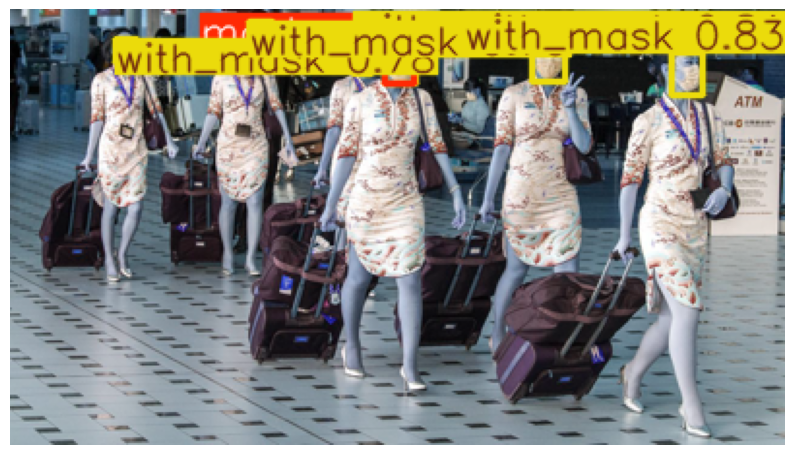


0: 288x416 3 with_masks, 1 without_mask, 52.7ms
Speed: 1.3ms preprocess, 52.7ms inference, 1.9ms postprocess per image at shape (1, 3, 288, 416)


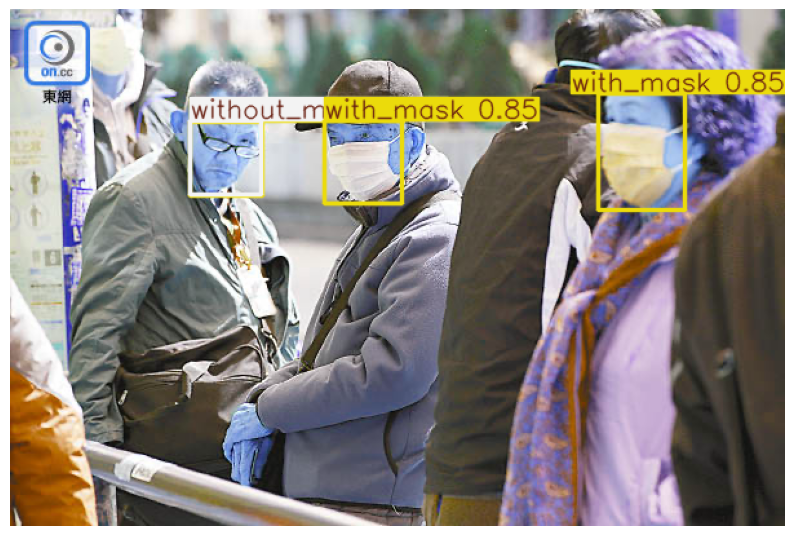


0: 416x320 1 without_mask, 54.7ms
Speed: 1.5ms preprocess, 54.7ms inference, 1.6ms postprocess per image at shape (1, 3, 416, 320)


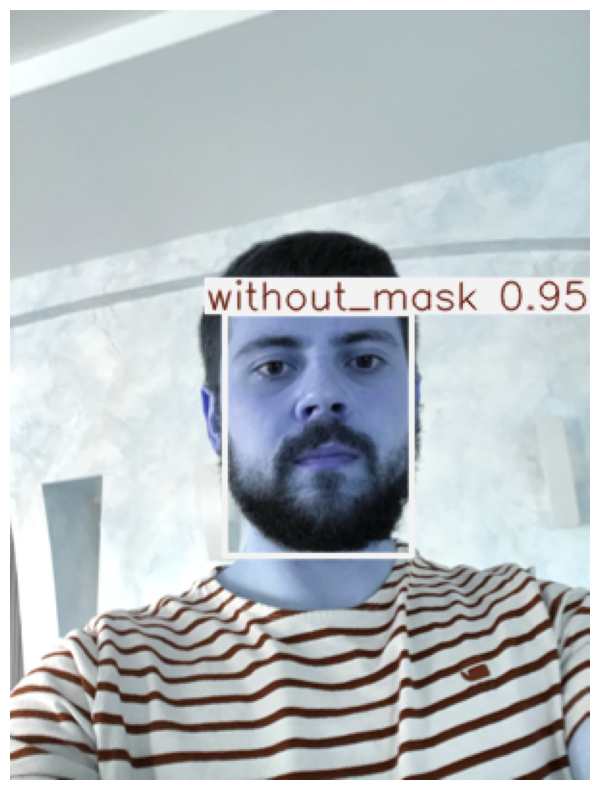


0: 224x416 6 with_masks, 2 without_masks, 51.3ms
Speed: 1.2ms preprocess, 51.3ms inference, 1.5ms postprocess per image at shape (1, 3, 224, 416)


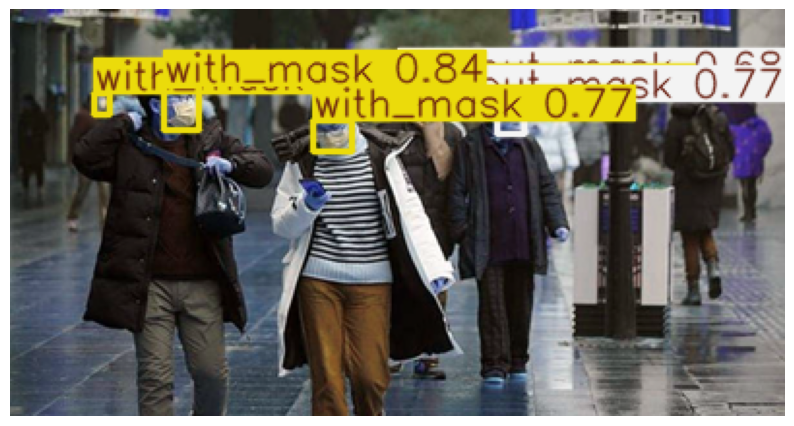


0: 416x320 1 with_mask, 9.3ms
Speed: 1.4ms preprocess, 9.3ms inference, 1.5ms postprocess per image at shape (1, 3, 416, 320)


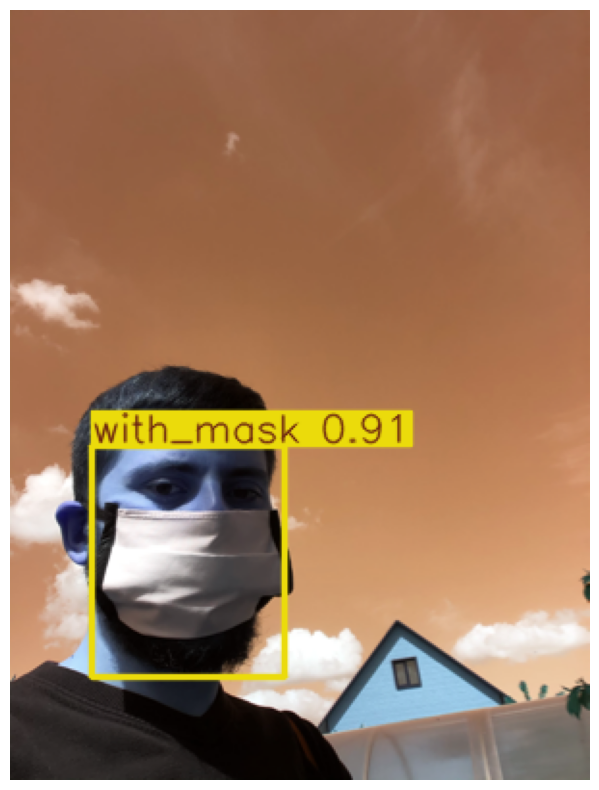


0: 288x416 1 with_mask, 9.9ms
Speed: 1.3ms preprocess, 9.9ms inference, 1.5ms postprocess per image at shape (1, 3, 288, 416)


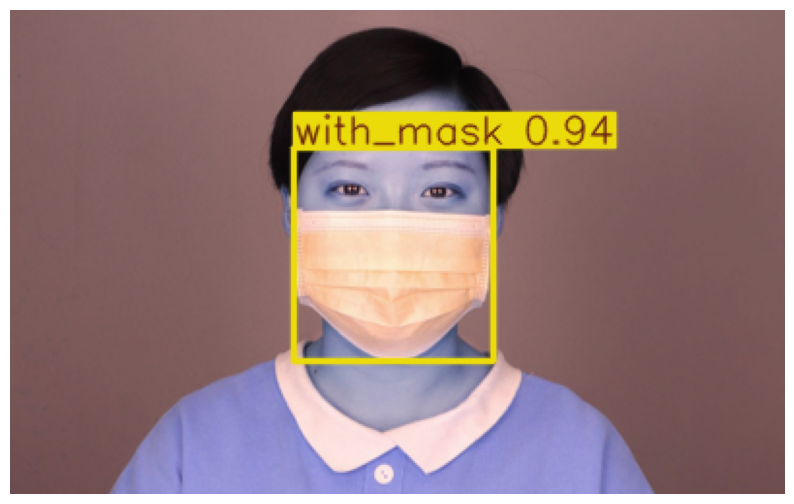


0: 416x288 1 with_mask, 53.0ms
Speed: 1.2ms preprocess, 53.0ms inference, 1.6ms postprocess per image at shape (1, 3, 416, 288)


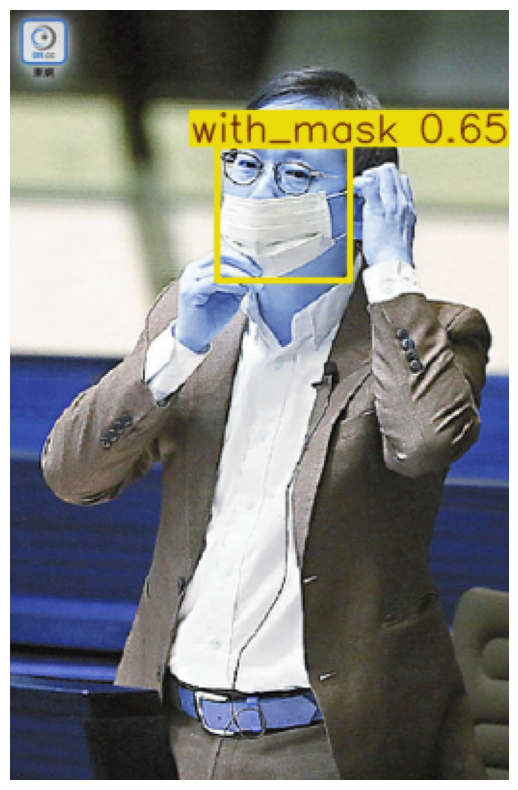


0: 320x416 4 with_masks, 49.8ms
Speed: 1.4ms preprocess, 49.8ms inference, 1.6ms postprocess per image at shape (1, 3, 320, 416)


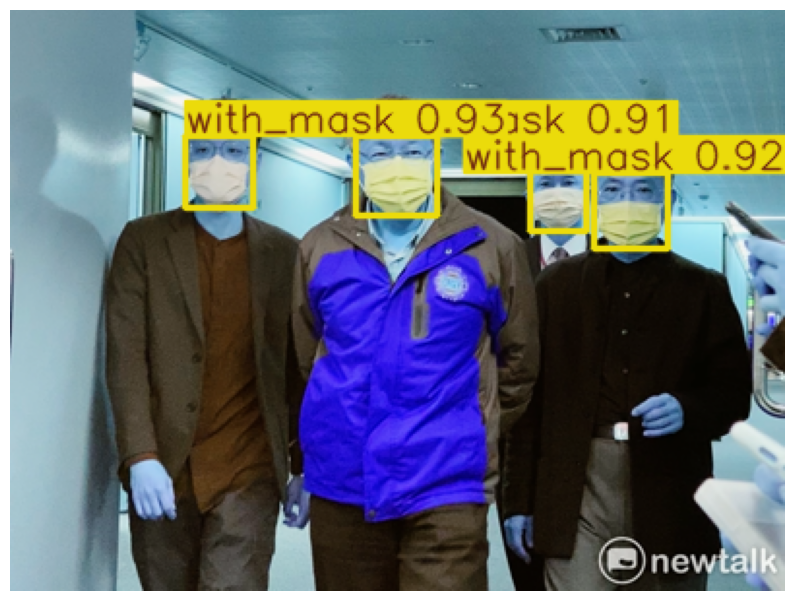


0: 288x416 8 with_masks, 1 without_mask, 8.9ms
Speed: 1.9ms preprocess, 8.9ms inference, 1.5ms postprocess per image at shape (1, 3, 288, 416)


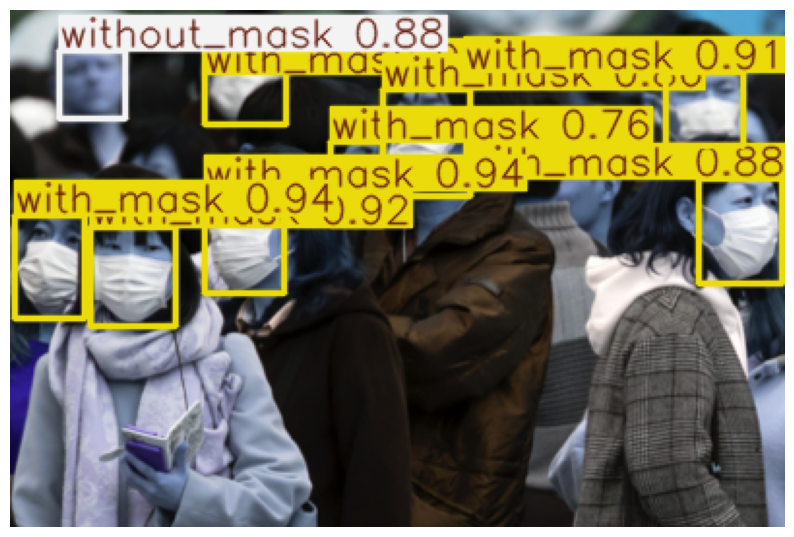


0: 256x416 3 with_masks, 4 without_masks, 9.2ms
Speed: 1.2ms preprocess, 9.2ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 416)


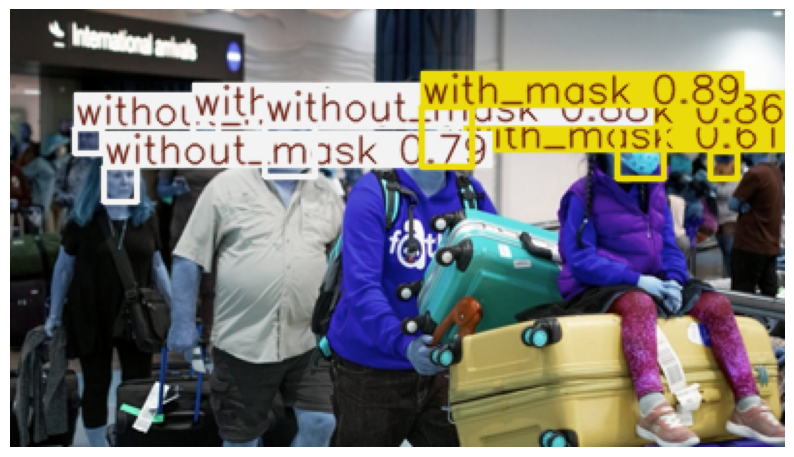


0: 416x320 1 with_mask, 9.2ms
Speed: 1.4ms preprocess, 9.2ms inference, 1.5ms postprocess per image at shape (1, 3, 416, 320)


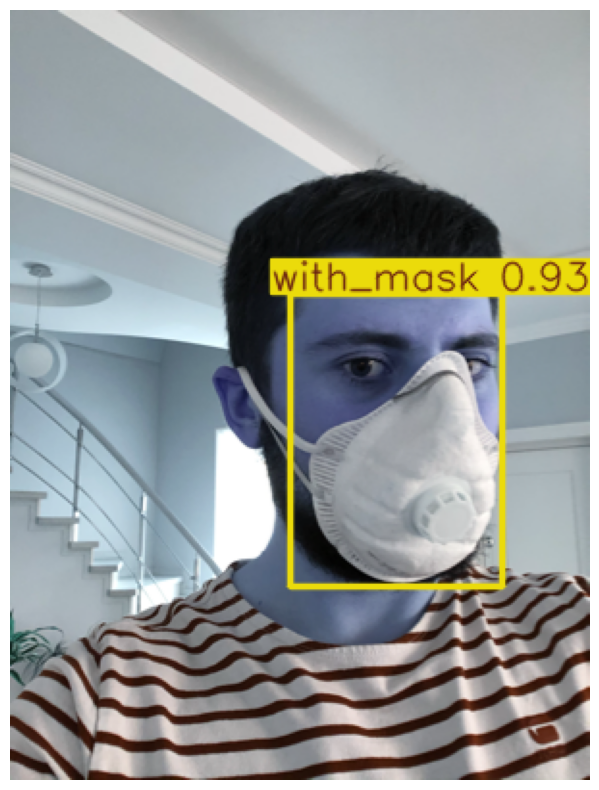


0: 288x416 6 with_masks, 2 without_masks, 9.3ms
Speed: 1.2ms preprocess, 9.3ms inference, 1.5ms postprocess per image at shape (1, 3, 288, 416)


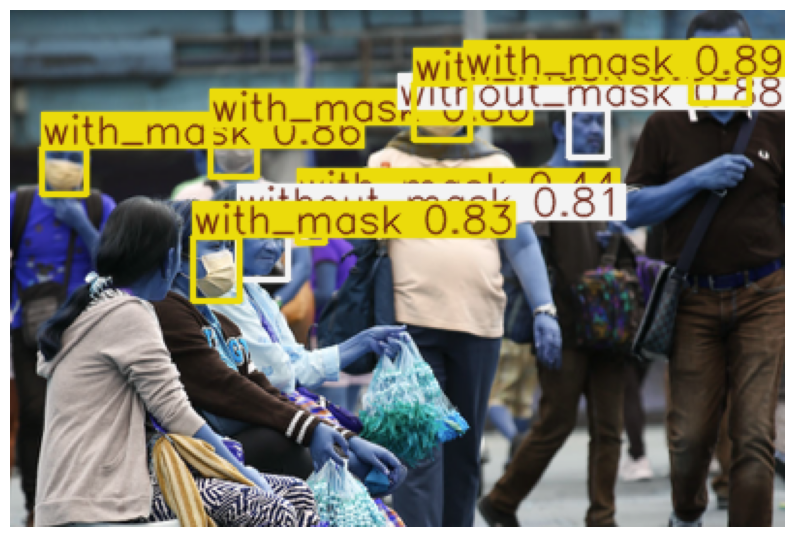


0: 416x288 1 with_mask, 9.0ms
Speed: 1.6ms preprocess, 9.0ms inference, 1.5ms postprocess per image at shape (1, 3, 416, 288)


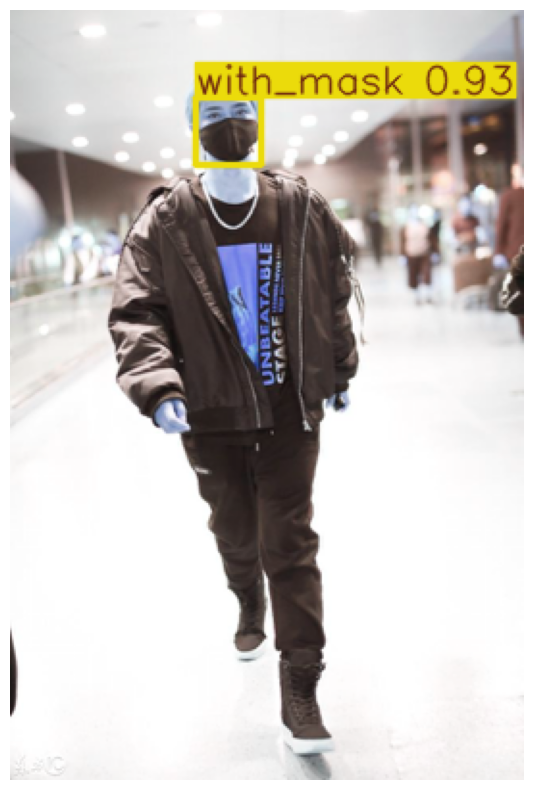


0: 224x416 3 with_masks, 9.3ms
Speed: 1.2ms preprocess, 9.3ms inference, 1.5ms postprocess per image at shape (1, 3, 224, 416)


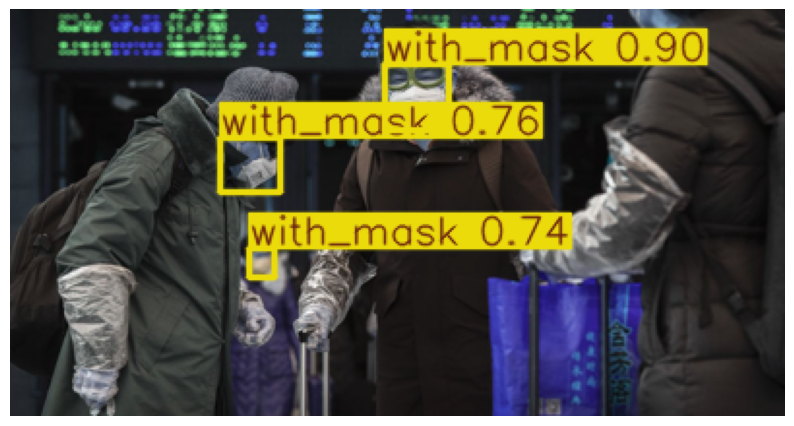


0: 256x416 4 with_masks, 1 without_mask, 9.0ms
Speed: 1.4ms preprocess, 9.0ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 416)


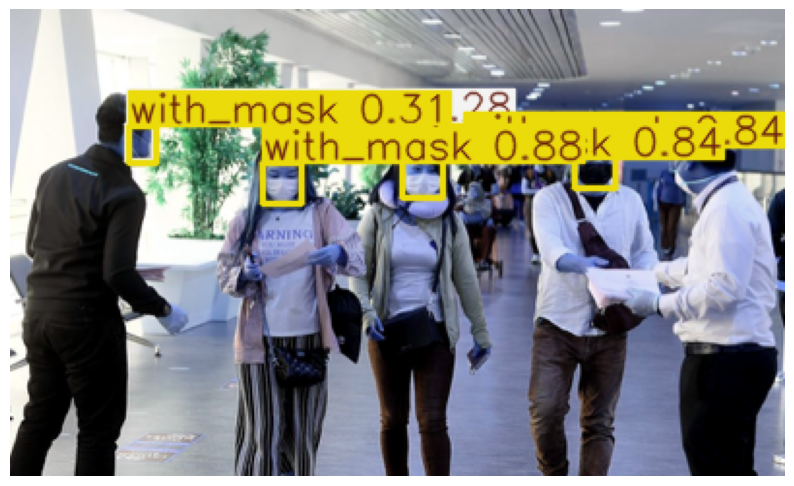


0: 416x320 1 with_mask, 9.0ms
Speed: 1.6ms preprocess, 9.0ms inference, 1.5ms postprocess per image at shape (1, 3, 416, 320)


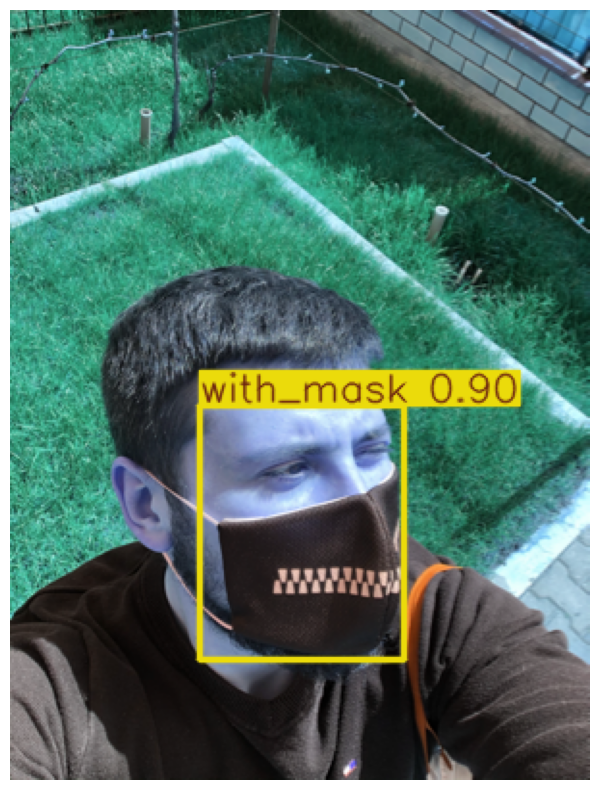


0: 416x288 1 mask_weared_incorrect, 1 with_mask, 9.6ms
Speed: 1.3ms preprocess, 9.6ms inference, 1.6ms postprocess per image at shape (1, 3, 416, 288)


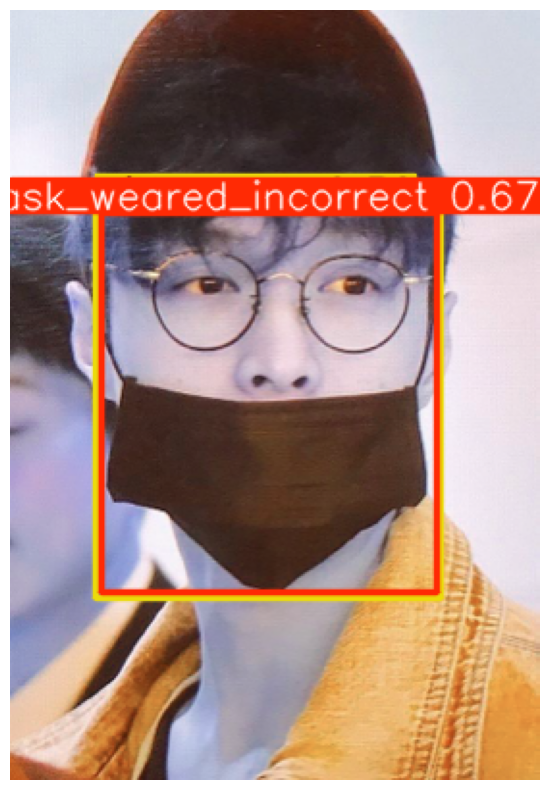


0: 416x416 2 with_masks, 11.0ms
Speed: 2.2ms preprocess, 11.0ms inference, 1.8ms postprocess per image at shape (1, 3, 416, 416)


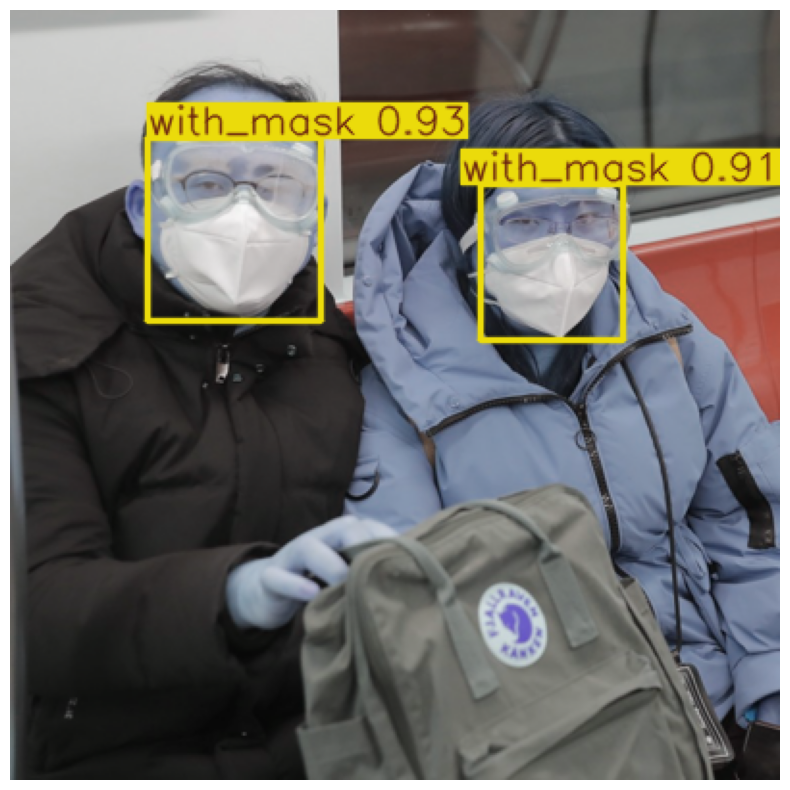


0: 416x416 1 with_mask, 8.6ms
Speed: 1.7ms preprocess, 8.6ms inference, 1.6ms postprocess per image at shape (1, 3, 416, 416)


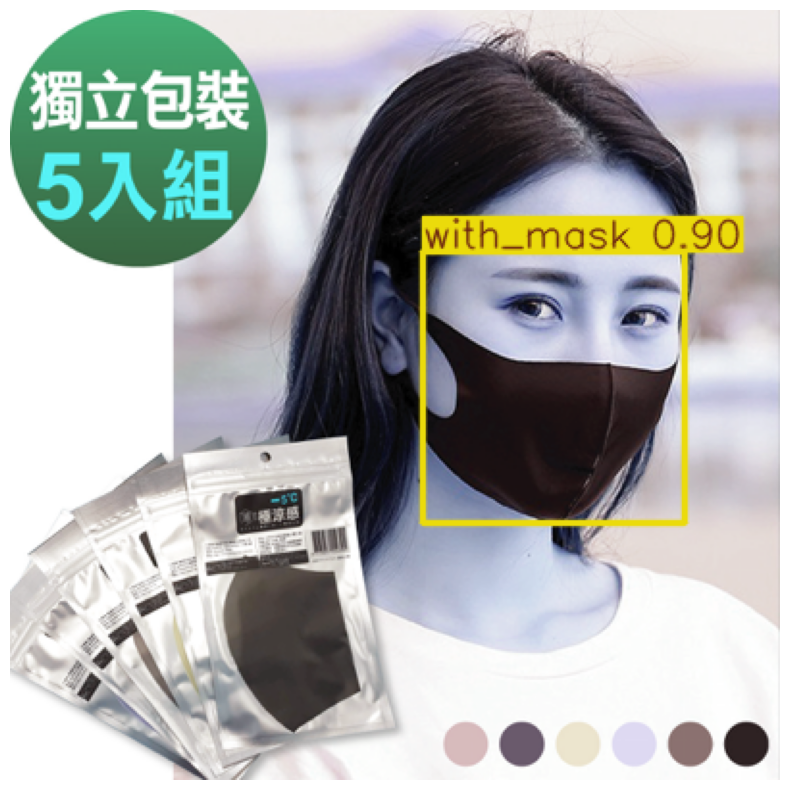


0: 256x416 14 with_masks, 9.9ms
Speed: 1.3ms preprocess, 9.9ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 416)


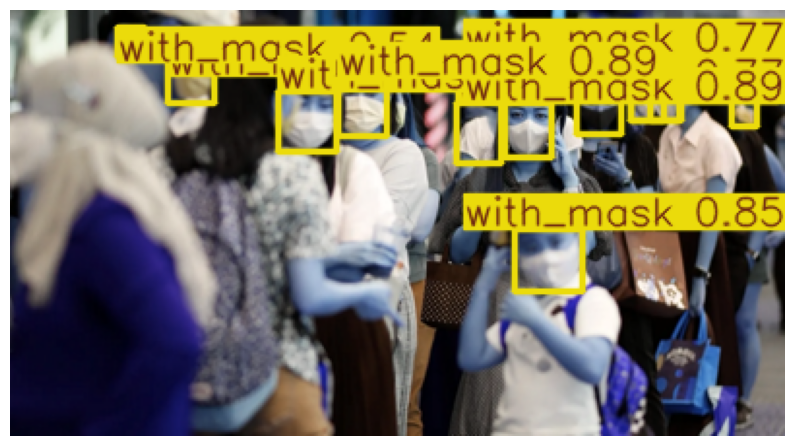


0: 416x320 1 with_mask, 8.8ms
Speed: 1.3ms preprocess, 8.8ms inference, 1.5ms postprocess per image at shape (1, 3, 416, 320)


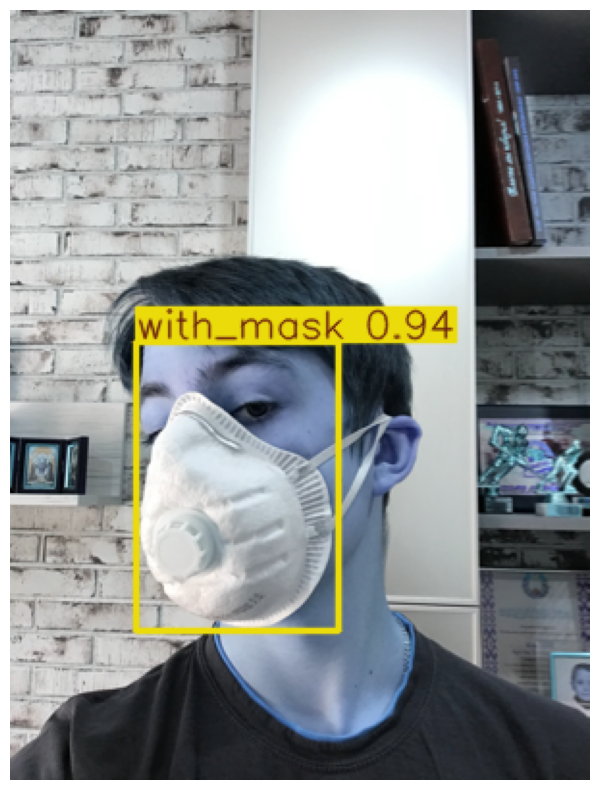


0: 256x416 4 with_masks, 3 without_masks, 9.3ms
Speed: 1.1ms preprocess, 9.3ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 416)


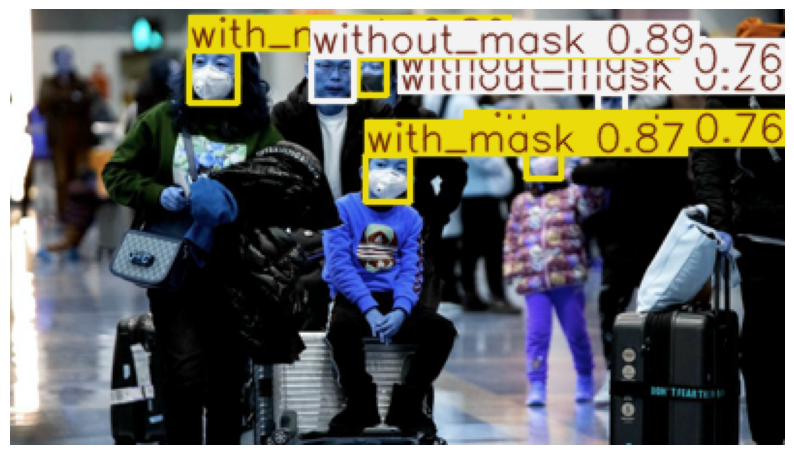


0: 288x416 9 with_masks, 9.4ms
Speed: 1.7ms preprocess, 9.4ms inference, 1.5ms postprocess per image at shape (1, 3, 288, 416)


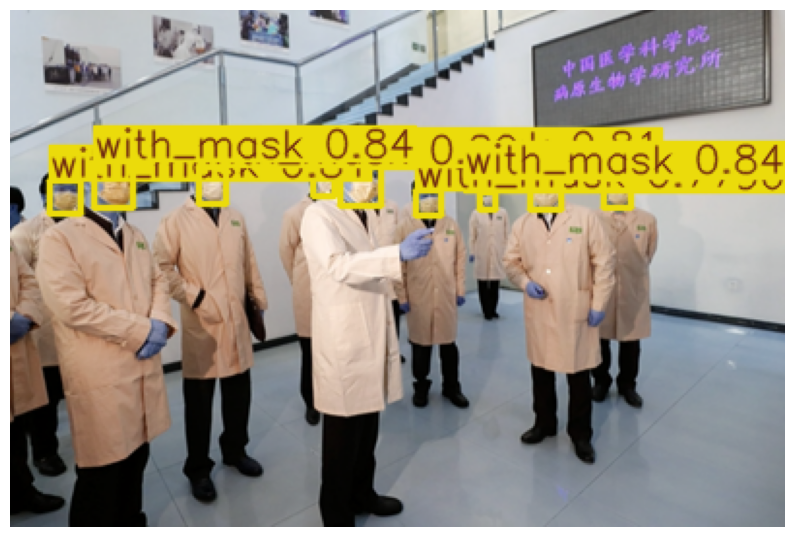


0: 416x320 1 without_mask, 9.1ms
Speed: 1.7ms preprocess, 9.1ms inference, 1.5ms postprocess per image at shape (1, 3, 416, 320)


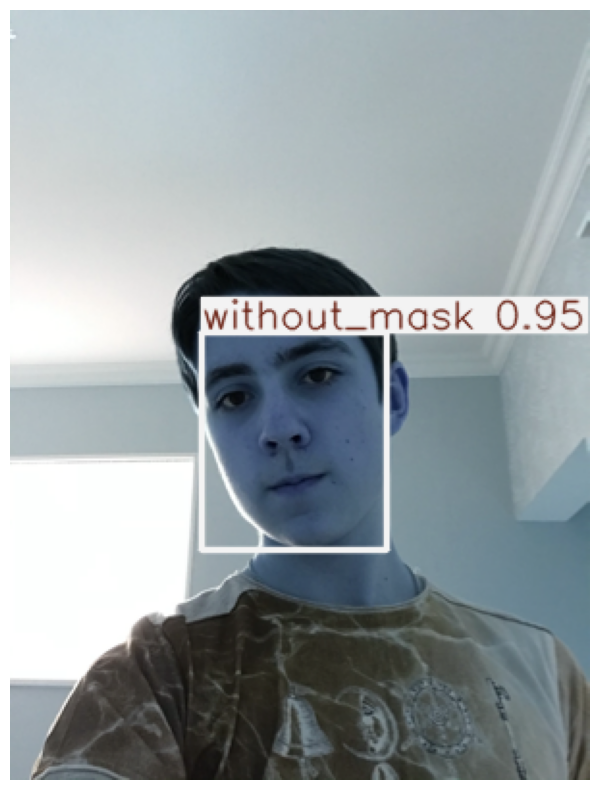


0: 416x320 1 without_mask, 10.5ms
Speed: 1.9ms preprocess, 10.5ms inference, 1.9ms postprocess per image at shape (1, 3, 416, 320)


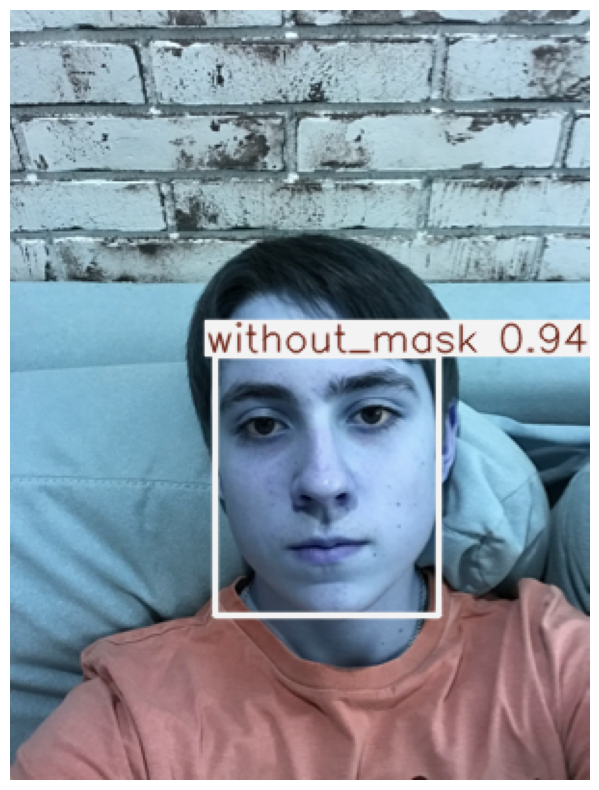

In [20]:
# Display sample images with detections
def plot_sample_images(image_dir, model, num_images=25):
    images = [os.path.join(image_dir, img) for img in os.listdir(image_dir)][:num_images]
    for img_path in images:
        img = cv2.imread(img_path)
        results = model(img)
        result_img = results[0].plot()  # Plot results on the image
        plt.figure(figsize=(10, 10))
        plt.imshow(result_img)
        plt.axis('off')
        plt.show()

plot_sample_images(os.path.join(OUTPUT_DIR, 'images', 'val'), model)


0: 416x416 1 with_mask, 12.3ms
Speed: 1.9ms preprocess, 12.3ms inference, 2.0ms postprocess per image at shape (1, 3, 416, 416)


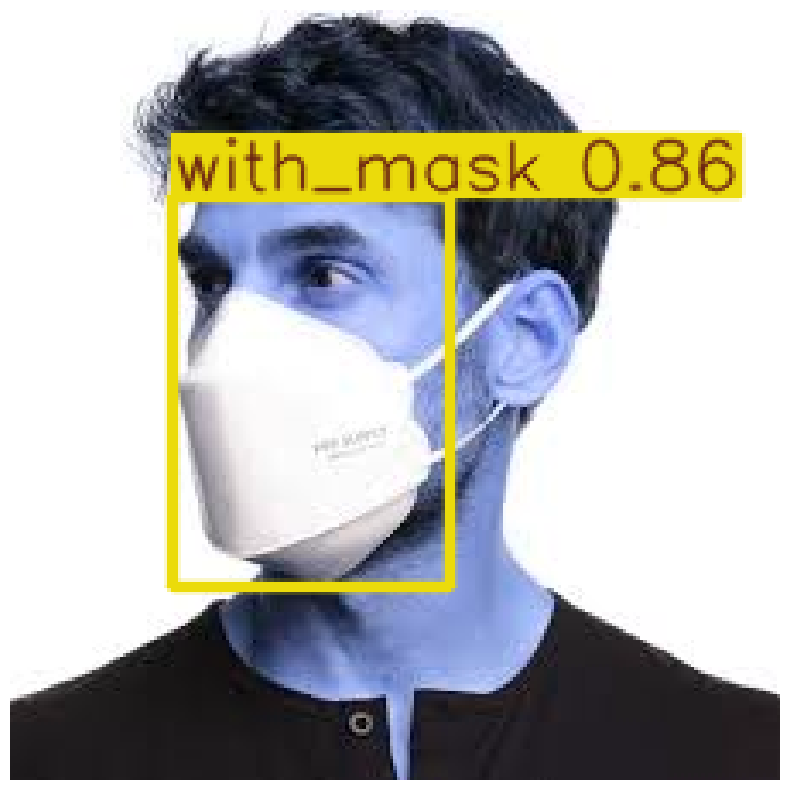


0: 416x416 1 with_mask, 12.0ms
Speed: 1.9ms preprocess, 12.0ms inference, 2.2ms postprocess per image at shape (1, 3, 416, 416)


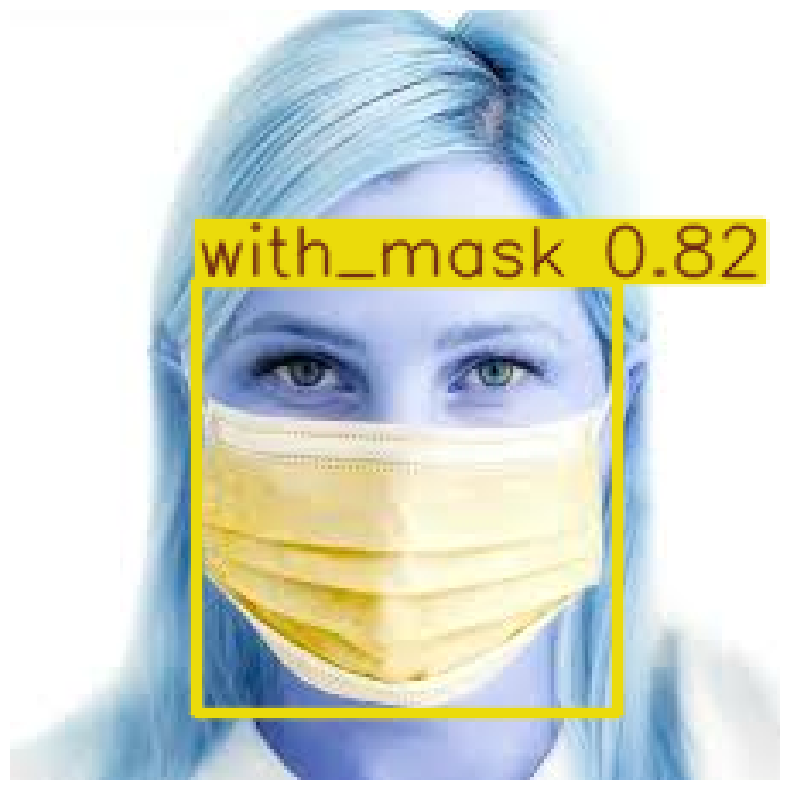


0: 416x416 1 with_mask, 12.2ms
Speed: 2.0ms preprocess, 12.2ms inference, 2.1ms postprocess per image at shape (1, 3, 416, 416)


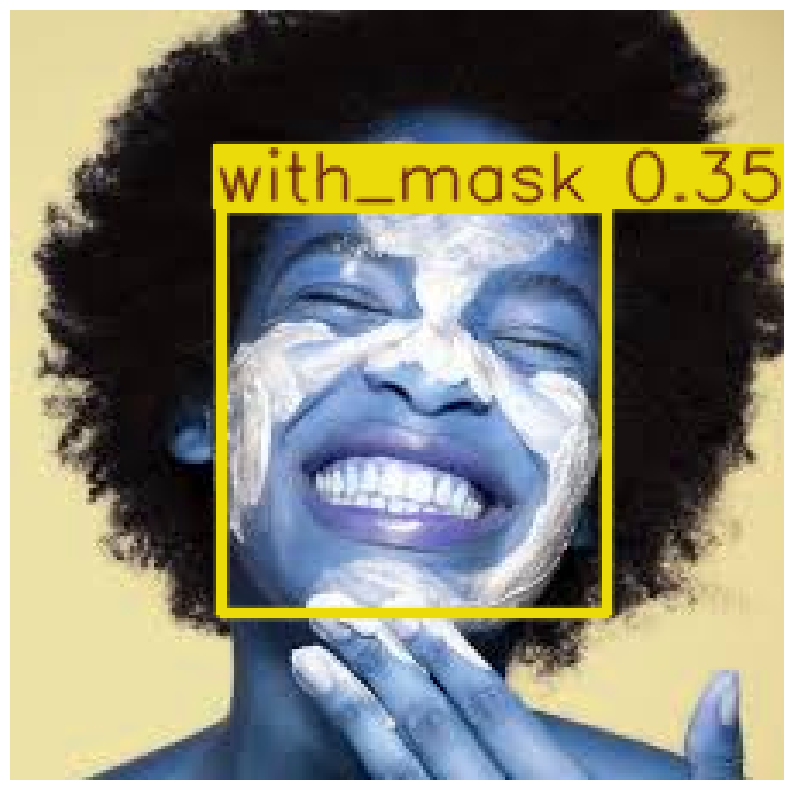


0: 416x416 1 with_mask, 9.1ms
Speed: 2.5ms preprocess, 9.1ms inference, 1.9ms postprocess per image at shape (1, 3, 416, 416)


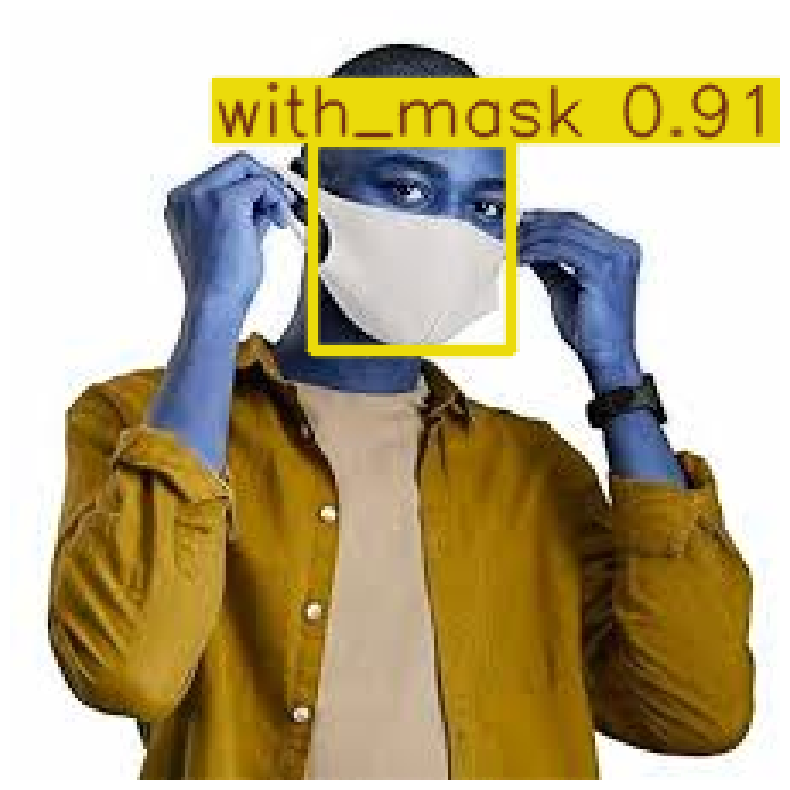


0: 416x352 1 without_mask, 47.8ms
Speed: 1.5ms preprocess, 47.8ms inference, 1.6ms postprocess per image at shape (1, 3, 416, 352)


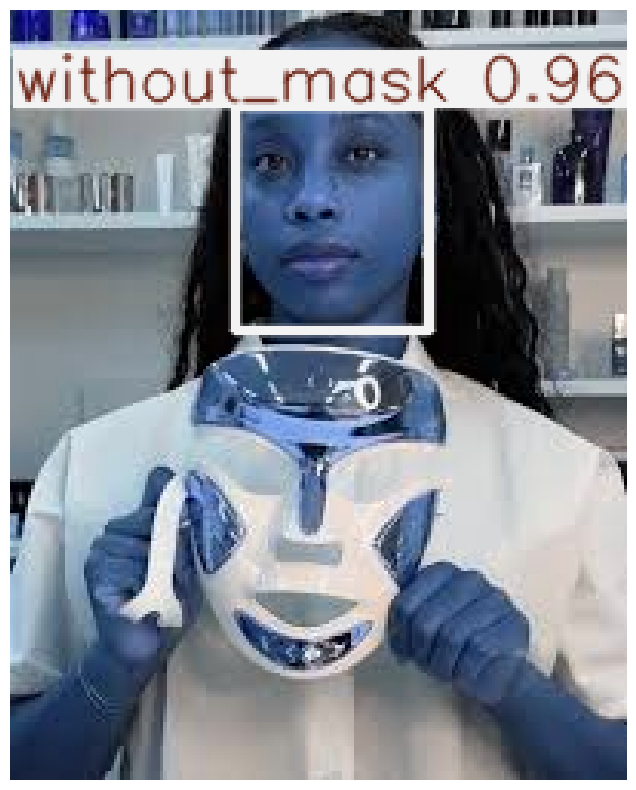


0: 416x416 (no detections), 9.8ms
Speed: 1.4ms preprocess, 9.8ms inference, 0.6ms postprocess per image at shape (1, 3, 416, 416)


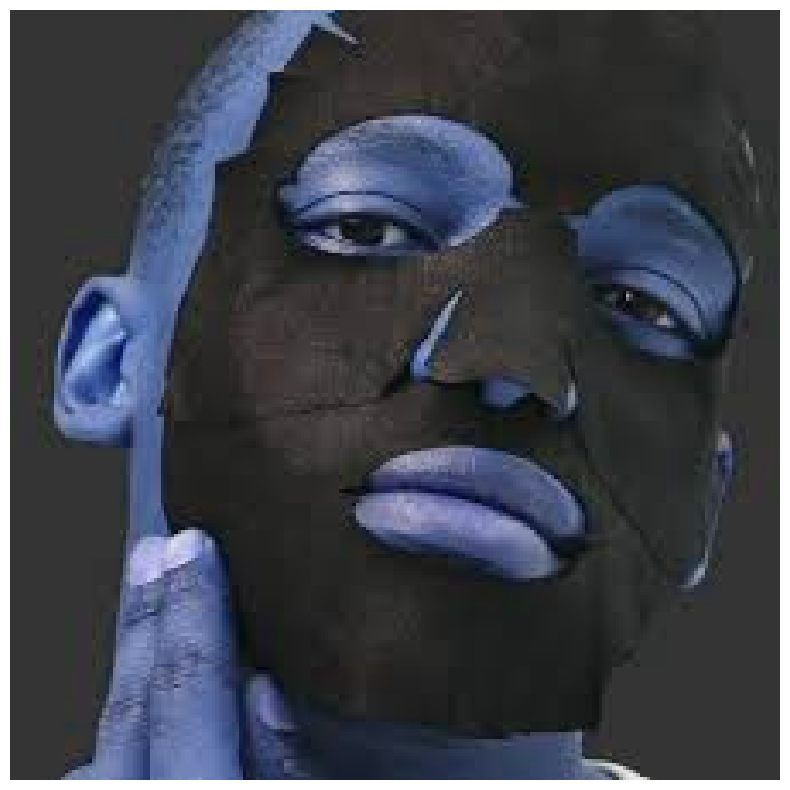


0: 416x416 (no detections), 8.3ms
Speed: 1.5ms preprocess, 8.3ms inference, 0.6ms postprocess per image at shape (1, 3, 416, 416)


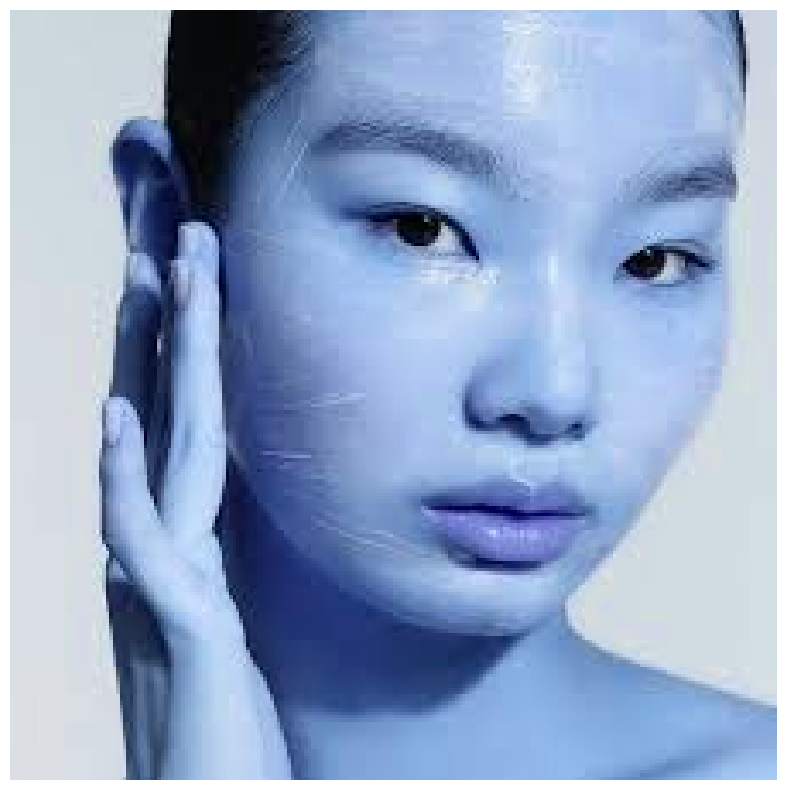


0: 256x416 2 with_masks, 1 without_mask, 8.9ms
Speed: 1.3ms preprocess, 8.9ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 416)


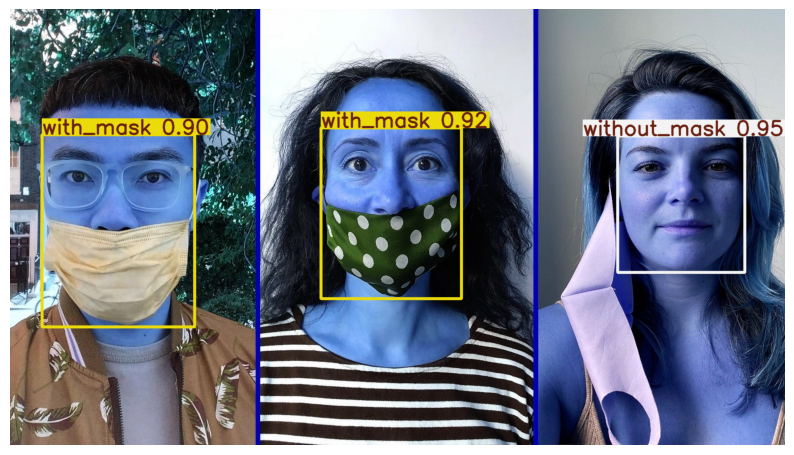


0: 256x416 2 mask_weared_incorrects, 3 with_masks, 4 without_masks, 9.9ms
Speed: 1.3ms preprocess, 9.9ms inference, 2.1ms postprocess per image at shape (1, 3, 256, 416)


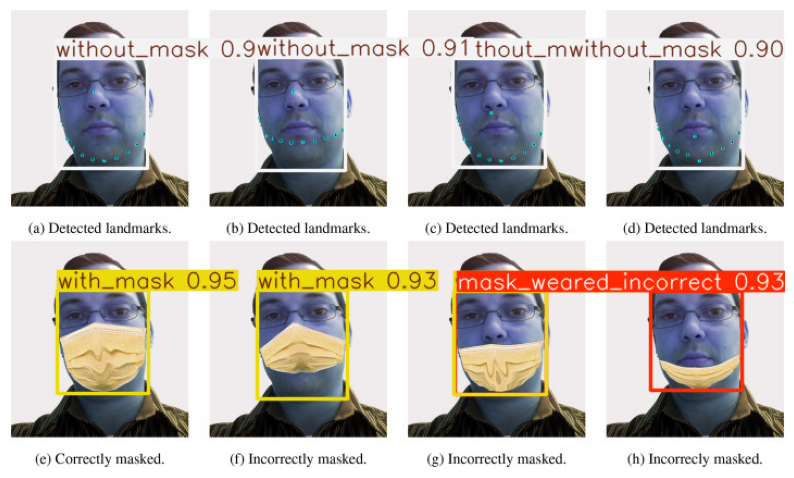


0: 288x416 1 mask_weared_incorrect, 10.5ms
Speed: 1.6ms preprocess, 10.5ms inference, 1.5ms postprocess per image at shape (1, 3, 288, 416)


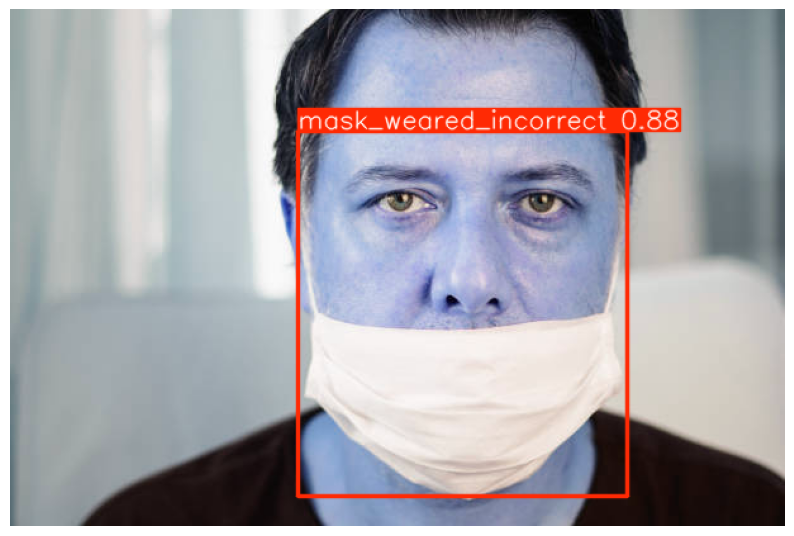


0: 256x416 1 with_mask, 10.5ms
Speed: 1.4ms preprocess, 10.5ms inference, 1.5ms postprocess per image at shape (1, 3, 256, 416)


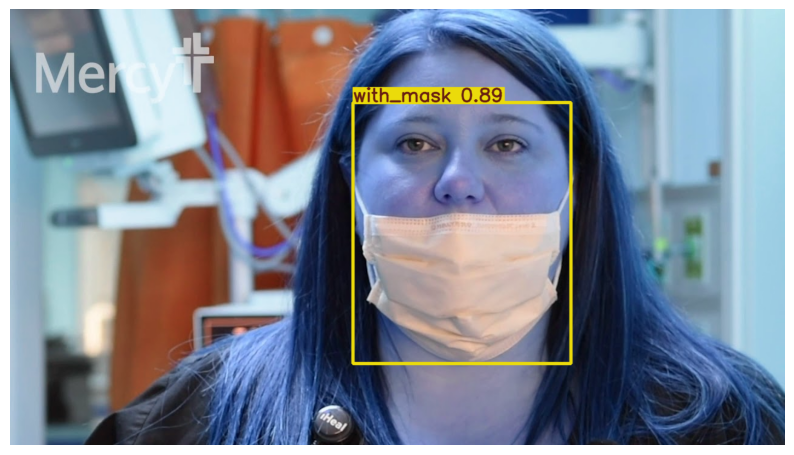


0: 416x416 1 with_mask, 9.0ms
Speed: 1.9ms preprocess, 9.0ms inference, 1.4ms postprocess per image at shape (1, 3, 416, 416)


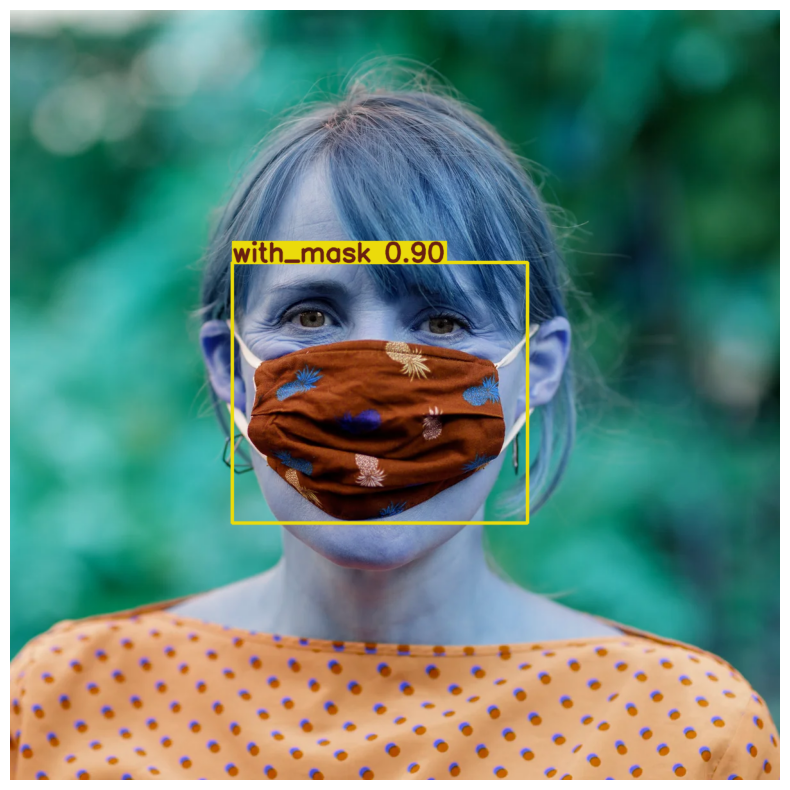


0: 288x416 1 mask_weared_incorrect, 1 with_mask, 13.4ms
Speed: 1.7ms preprocess, 13.4ms inference, 1.7ms postprocess per image at shape (1, 3, 288, 416)


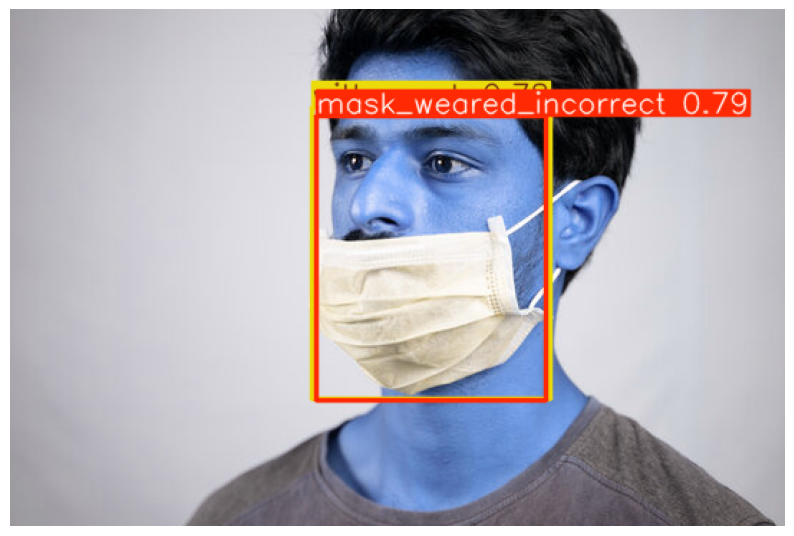


0: 288x416 1 mask_weared_incorrect, 1 with_mask, 8.2ms
Speed: 1.6ms preprocess, 8.2ms inference, 1.5ms postprocess per image at shape (1, 3, 288, 416)


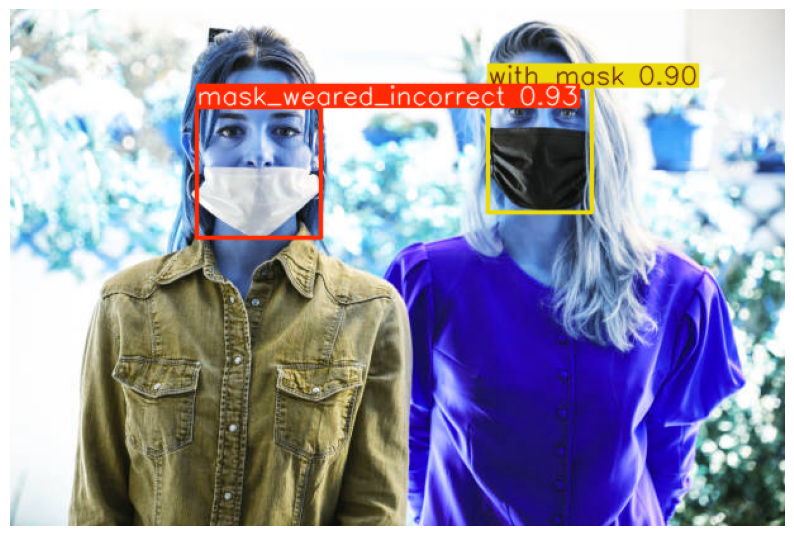

In [21]:
# Display sample images with detections
def plot_sample_images(image_dir, model, num_images=14):
    images = [os.path.join(image_dir, img) for img in os.listdir(image_dir)][:num_images]
    for img_path in images:
        img = cv2.imread(img_path)
        results = model(img)
        result_img = results[0].plot()  # Plot results on the image
        plt.figure(figsize=(10, 10))
        plt.imshow(result_img)
        plt.axis('off')
        plt.show()

plot_sample_images(test_images, model)